# Data Exploration
---
In this notebook we explore the independant and dependant variables, both seperately and with respect to one another. The independant variables here are the molecular descriptors which describe the structure of the molecules that were tested in the 2014 experiment [cite]. The dependant variables here are the perceptual ratings (from 0-100) that the subjects of the above experiment could provide such as "Fruit", "Fish", "Garlic" & "Spices". 

First, we will explore the perceptual or phenomonological data. Then move onto the molecular descriptors and finally we shall combine them and perform some analysis.

## Perceptual data - smells or odors assigned to chemicals

### Imports

In [1]:
# Math Libraries
import scipy
import numpy as np
import pandas as pd

# Visalisation
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sb
sb.set_style('whitegrid')

# I/O
import json
import xlrd

# Machine Learning
import sklearn
import sklearn.decomposition

# Utility
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

### Paths

In [3]:
path_to_transformed_data = "../../data/transformed/"
path_to_data = "../../data/"

### Read Data

In [7]:
# Read in perceptual dataset from 2014 Keller & Voshal Study [cite]
keller_data = pd.read_excel(path_to_data + 'KellerData.xlsx',
                           header=1, skiprows=1)

In [8]:
# Strip whitespace from column names
keller_data = keller_data.rename(columns=lambda x: x.strip())

# Rename verbose columns for readability
keller_data = keller_data.rename(index=str, columns={
    "HOW STRONG IS THE SMELL?": "INTENSITY",
    "HOW PLEASANT IS THE SMELL?": "PLEASANTNESS",
    "AMMONIA/URINOUS": "URINOUS",
    "Subject # (DREAM challenge)": "SUBJECT",
    "C.A.S.": "CAS",
    "Race\n (\"unknown\" indicates\n that the subject did not\n wish to specify)": "Race",
    "HOW FAMILIAR IS THE SMELL?": "FAMILIARITY"})

In [4]:
# Load transformed perceptual descriptors
zero_imputation = pd.read_pickle(path_to_transformed_data + "zero_imputation.zip")
mean_imputation = pd.read_pickle(path_to_transformed_data + "mean_imputation.zip")
median_imputation = pd.read_pickle(path_to_transformed_data + "median_imputation.zip")
mean_median_average_imputation = pd.read_pickle(path_to_transformed_data + "mean_median_average_imputation.zip")

In [9]:
# Displays first 5 rows of each dataframe containing a different imputation method
print("### Raw Data ###") 
keller_data.iloc[0:5, 15:38]
print("### Zero Impute ###") 
zero_imputation.iloc[0:5, 15:38]
print("### Mean Impute ###") 
mean_imputation.iloc[0:5, 15:38]
print("### Median Impute ###") 
median_imputation.iloc[0:5, 15:38]
print("### Mean/Median Average ###") 
mean_median_average_imputation.iloc[0:5, 15:38]

### Raw Data ###


,INTENSITY,PLEASANTNESS,FAMILIARITY,EDIBLE,BAKERY,SWEET,FRUIT,FISH,GARLIC,SPICES,...,ACID,WARM,MUSKY,SWEATY,URINOUS,DECAYED,WOOD,GRASS,FLOWER,CHEMICAL
0,59.0,64.0,66.0,NaN,NaN,16.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,38.0,60.0,44.0,NaN,NaN,57.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,58.0,34.0,16.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,63.0,NaN,NaN,NaN,NaN
3,2.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,0.0,48.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,7.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Zero Impute ###


,INTENSITY,PLEASANTNESS,FAMILIARITY,EDIBLE,BAKERY,SWEET,FRUIT,FISH,GARLIC,SPICES,...,ACID,WARM,MUSKY,SWEATY,URINOUS,DECAYED,WOOD,GRASS,FLOWER,CHEMICAL
0,59.0,64.0,66.0,0.0,0.0,16.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,38.0,60.0,44.0,0.0,0.0,57.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,58.0,34.0,16.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,63.0,0.0,0.0,0.0,0.0
3,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,48.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,7.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


### Mean Impute ###


,INTENSITY,PLEASANTNESS,FAMILIARITY,EDIBLE,BAKERY,SWEET,FRUIT,FISH,GARLIC,SPICES,...,ACID,WARM,MUSKY,SWEATY,URINOUS,DECAYED,WOOD,GRASS,FLOWER,CHEMICAL
0,59.0,64.0,66.0,24.066667,16.666667,16.000000,17.0,22.500000,24.266667,25.304348,...,27.300000,23.200000,33.375000,26.352941,24.631579,26.000000,19.066667,11.50,8.714286,31.321429
1,38.0,60.0,44.0,24.066667,16.666667,57.000000,17.0,22.500000,24.266667,25.304348,...,27.300000,23.200000,33.375000,26.352941,24.631579,26.000000,19.066667,11.50,8.714286,31.321429
2,58.0,34.0,16.0,24.363636,4.000000,35.588235,23.8,14.000000,22.875000,24.200000,...,27.777778,19.333333,23.238095,27.500000,16.285714,63.000000,14.777778,30.25,15.625000,21.600000
3,2.0,0.0,0.0,24.363636,4.000000,35.588235,23.8,14.000000,22.875000,24.200000,...,27.777778,19.333333,23.238095,27.500000,16.285714,19.300000,14.777778,30.25,15.625000,21.600000
4,0.0,48.0,0.0,32.777778,32.666667,24.956522,32.5,40.777778,29.500000,7.000000,...,24.714286,20.461538,34.379310,21.466667,30.210526,26.619048,19.333333,27.00,27.764706,35.806452


### Median Impute ###


,INTENSITY,PLEASANTNESS,FAMILIARITY,EDIBLE,BAKERY,SWEET,FRUIT,FISH,GARLIC,SPICES,...,ACID,WARM,MUSKY,SWEATY,URINOUS,DECAYED,WOOD,GRASS,FLOWER,CHEMICAL
0,59.0,64.0,66.0,14.0,11.0,16.0,1.0,14.0,12.0,17.0,...,16.5,9.0,25.0,28.0,22.0,23.0,13.0,7.0,4.0,33.5
1,38.0,60.0,44.0,14.0,11.0,57.0,1.0,14.0,12.0,17.0,...,16.5,9.0,25.0,28.0,22.0,23.0,13.0,7.0,4.0,33.5
2,58.0,34.0,16.0,25.0,4.0,34.0,18.0,17.0,26.5,20.0,...,22.0,11.5,22.0,15.5,11.0,63.0,8.0,25.0,3.0,17.0
3,2.0,0.0,0.0,25.0,4.0,34.0,18.0,17.0,26.5,20.0,...,22.0,11.5,22.0,15.5,11.0,10.0,8.0,25.0,3.0,17.0
4,0.0,48.0,0.0,28.0,23.0,21.0,27.0,36.0,24.5,7.0,...,16.0,14.0,26.0,19.0,21.0,25.0,5.0,14.5,24.0,35.0


### Mean/Median Average ###


,INTENSITY,PLEASANTNESS,FAMILIARITY,EDIBLE,BAKERY,SWEET,FRUIT,FISH,GARLIC,SPICES,...,ACID,WARM,MUSKY,SWEATY,URINOUS,DECAYED,WOOD,GRASS,FLOWER,CHEMICAL
0,59.0,64.0,66.0,19.033333,13.833333,16.000000,9.00,18.250000,18.133333,21.152174,...,21.900000,16.100000,29.187500,27.176471,23.315789,24.500000,16.033333,9.250,6.357143,32.410714
1,38.0,60.0,44.0,19.033333,13.833333,57.000000,9.00,18.250000,18.133333,21.152174,...,21.900000,16.100000,29.187500,27.176471,23.315789,24.500000,16.033333,9.250,6.357143,32.410714
2,58.0,34.0,16.0,24.681818,4.000000,34.794118,20.90,15.500000,24.687500,22.100000,...,24.888889,15.416667,22.619048,21.500000,13.642857,63.000000,11.388889,27.625,9.312500,19.300000
3,2.0,0.0,0.0,24.681818,4.000000,34.794118,20.90,15.500000,24.687500,22.100000,...,24.888889,15.416667,22.619048,21.500000,13.642857,14.650000,11.388889,27.625,9.312500,19.300000
4,0.0,48.0,0.0,30.388889,27.833333,22.978261,29.75,38.388889,27.000000,7.000000,...,20.357143,17.230769,30.189655,20.233333,25.605263,25.809524,12.166667,20.750,25.882353,35.403226


## Looking at Missing Values - Dealing with NaN

### Effect on Pleasantness, Familiarity & Intensity

### Zero Imputation ###
### Pleasentness/Intensity/Familiarity ###


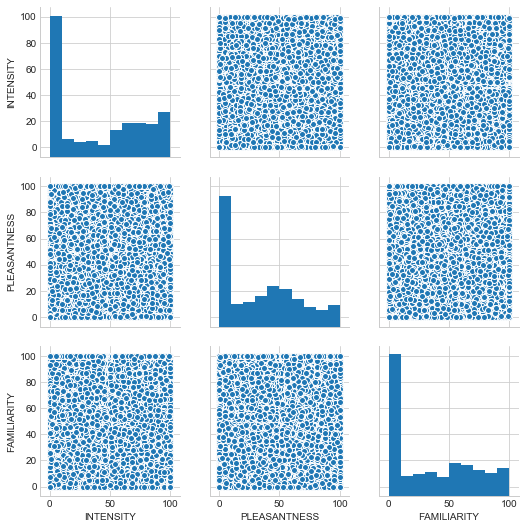

In [83]:
print("### Zero Imputation ###") 
print("### Pleasentness/Intensity/Familiarity ###") 
sb.pairplot(data=zero_imputation.iloc[:, 15:18])

### Mean Imputation ###
### Pleasentness/Intensity/Familiarity ###


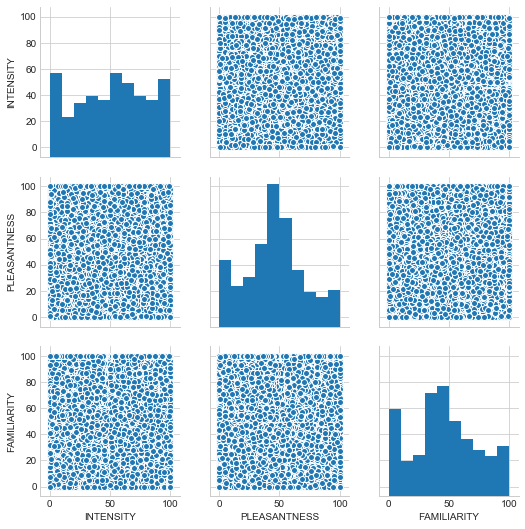

In [84]:
print("### Mean Imputation ###") 
print("### Pleasentness/Intensity/Familiarity ###") 
sb.pairplot(data=mean_imputation.iloc[:, 15:18])

### Median Imputation ###
### Pleasentness/Intensity/Familiarity ###


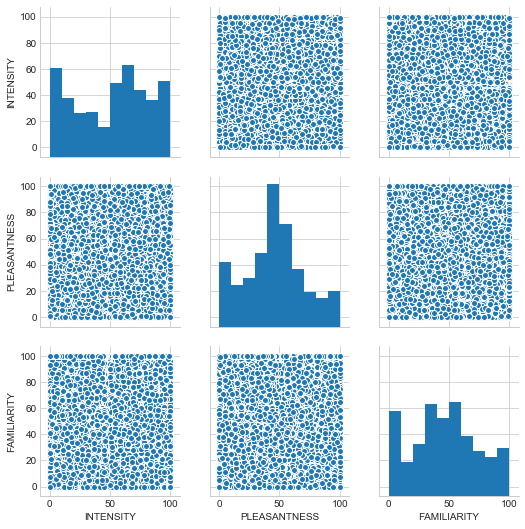

In [85]:
print("### Median Imputation ###") 
print("### Pleasentness/Intensity/Familiarity ###") 
sb.pairplot(data=median_imputation.iloc[:, 15:18])

### Mean/Median Averaged Imputation ###
### Pleasentness/Intensity/Familiarity ###


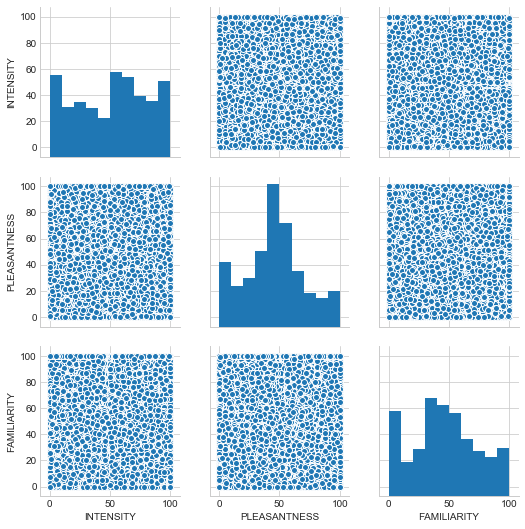

In [87]:
print("### Mean/Median Averaged Imputation ###") 
print("### Pleasentness/Intensity/Familiarity ###") 
sb.pairplot(data=mean_median_average_imputation.iloc[:, 15:18])

### Effect on Semantic Descriptors

#### Zero Imputation

### Zero Imputation ###
### Semantic Descriptors 1 ###


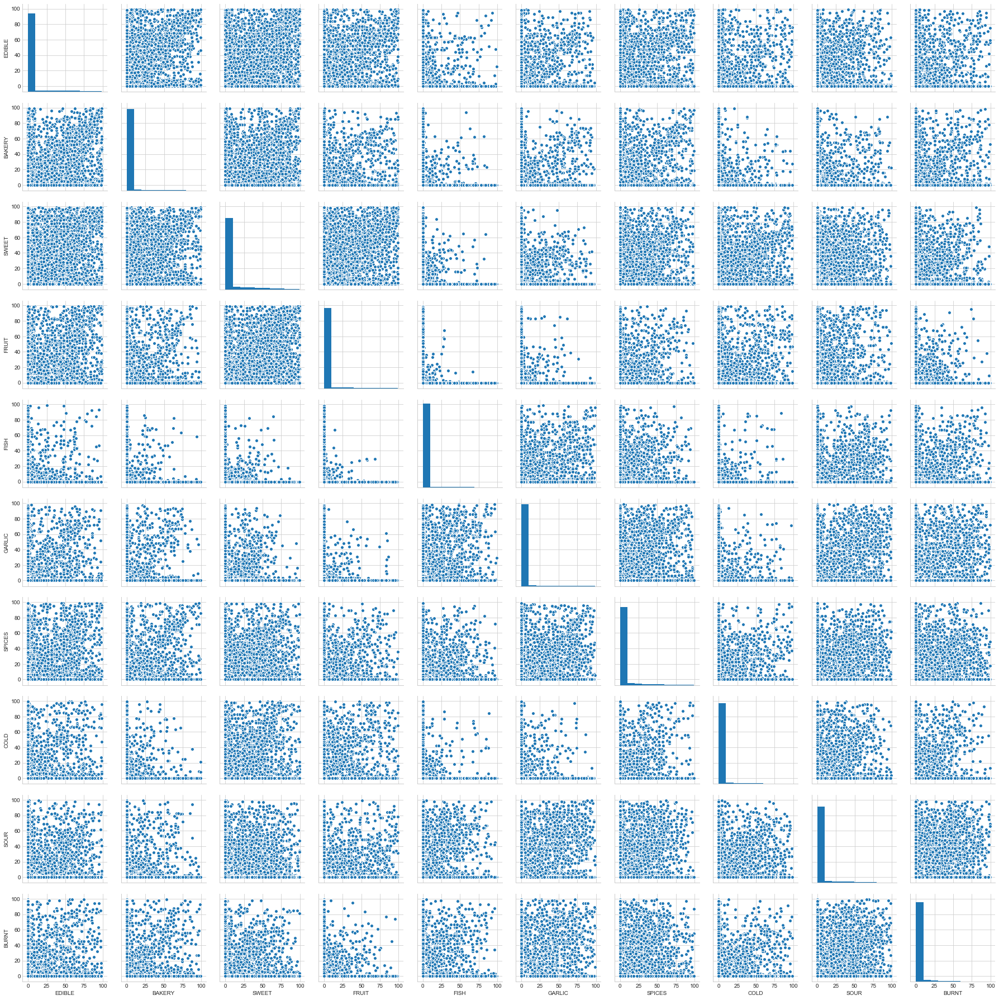

In [88]:
print("### Zero Imputation ###") 
print("### Semantic Descriptors 1 ###") 
sb.pairplot(data=zero_imputation.iloc[:, 18:28])

### Zero Imputation ###
### Semantic Descriptors 2 ###


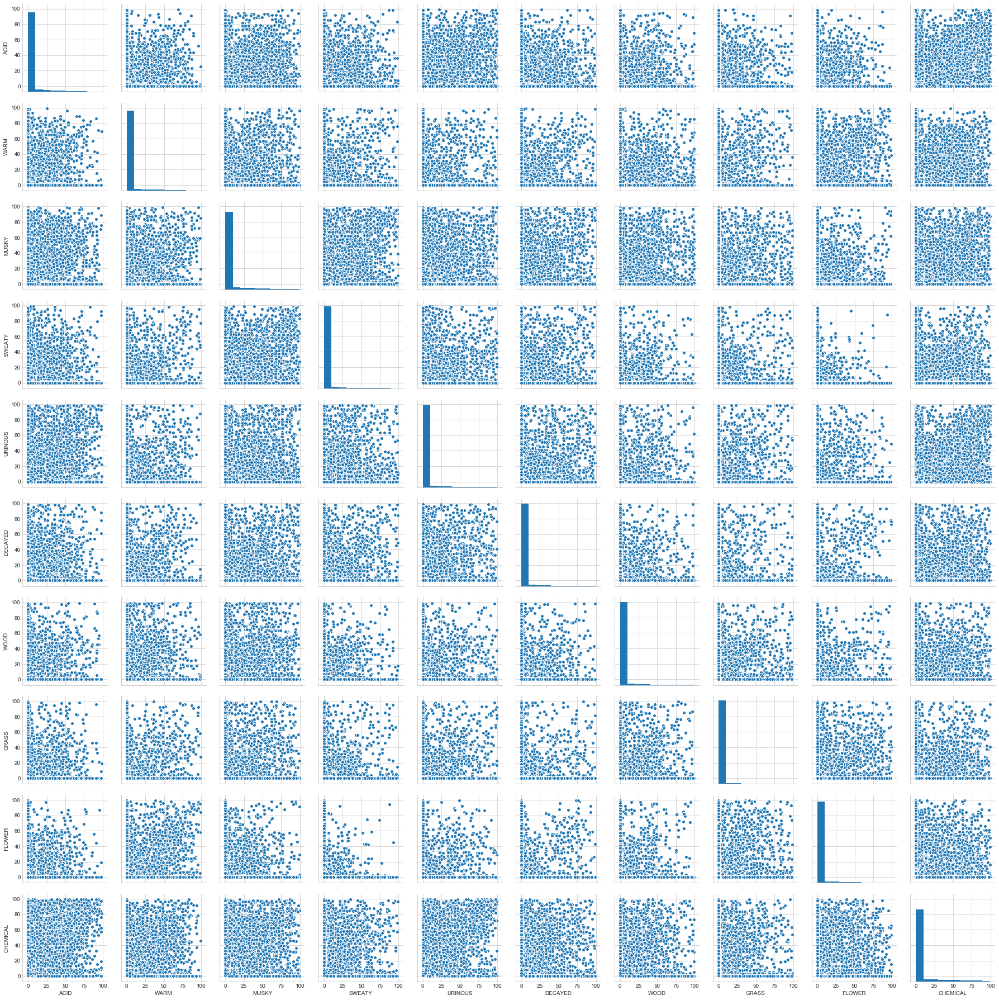

In [92]:
print("### Zero Imputation ###") 
print("### Semantic Descriptors 2 ###") 
sb.pairplot(data=zero_imputation.iloc[:, 28:38])

#### Mean Imputation

### Mean Imputation ###
### Semantic Descriptors 1 ###


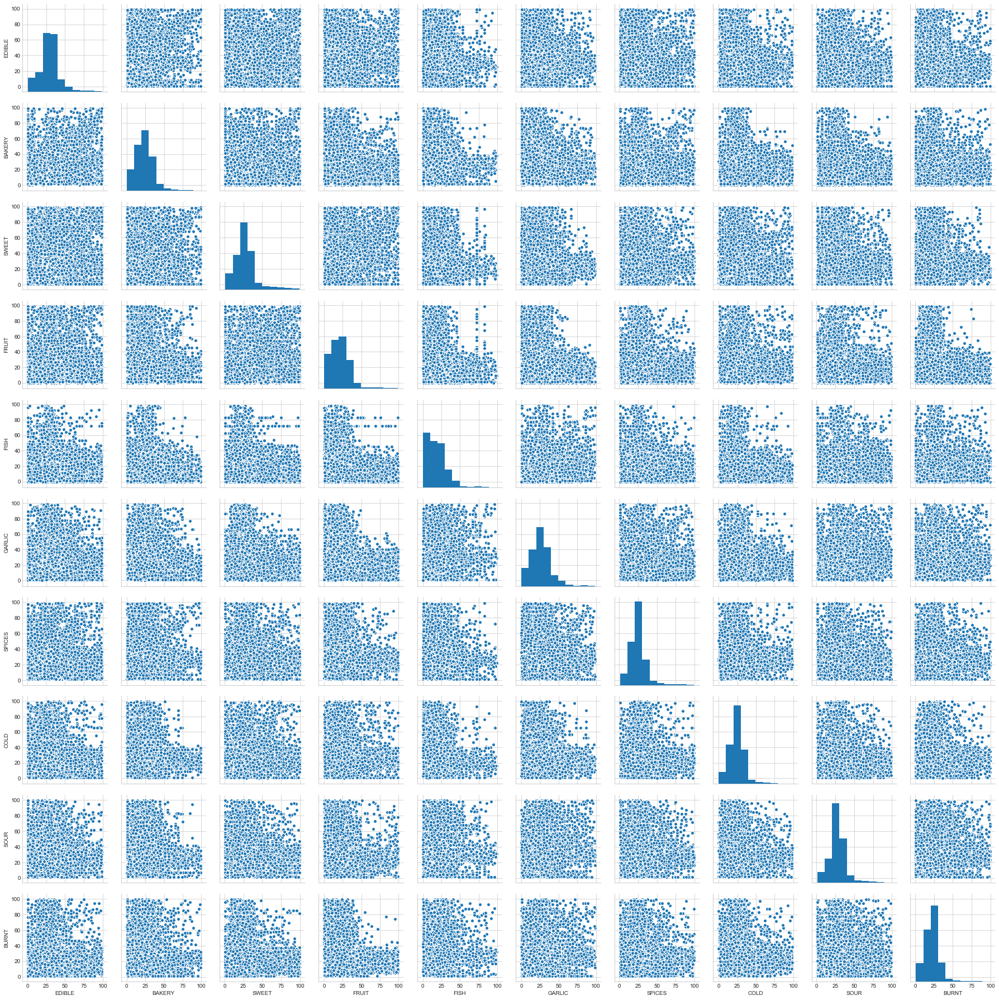

In [93]:
print("### Mean Imputation ###") 
print("### Semantic Descriptors 1 ###") 
sb.pairplot(data=mean_imputation.iloc[:, 18:28])

### Mean Imputation ###
### Semantic Descriptors 2 ###


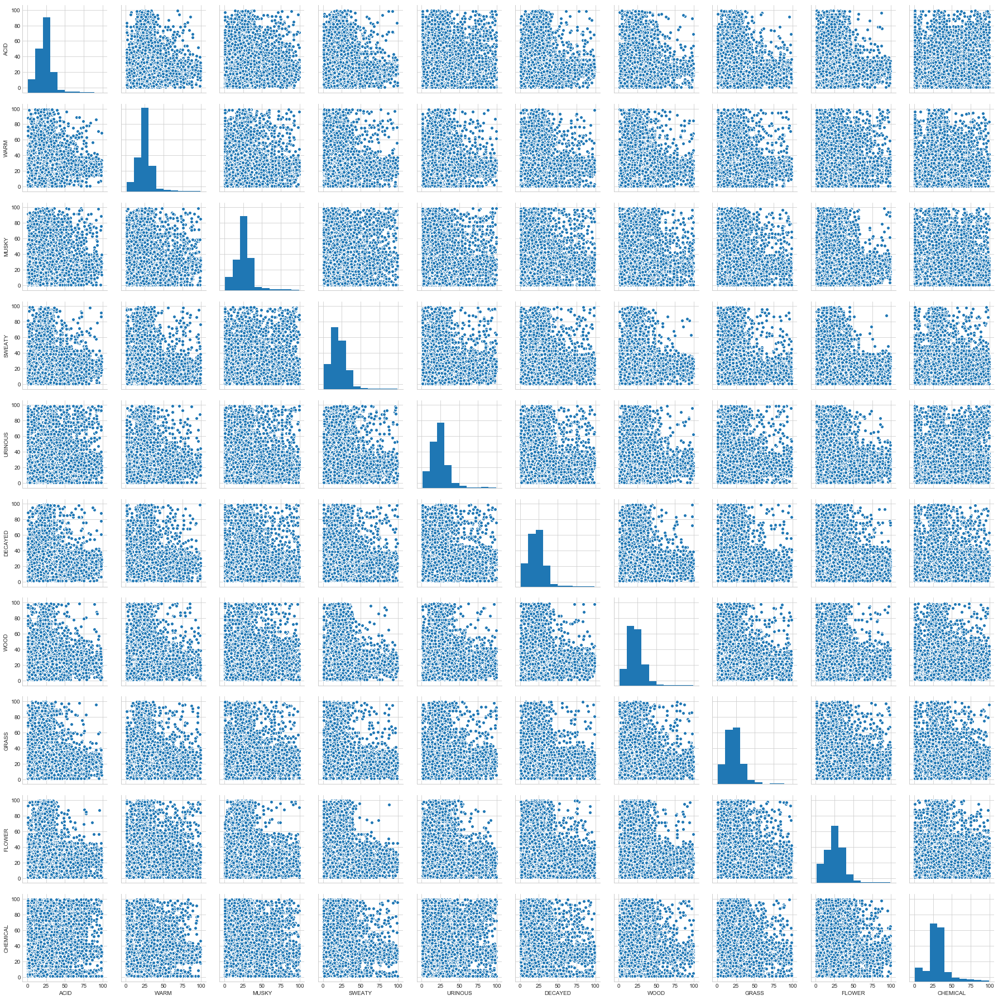

In [94]:
print("### Mean Imputation ###") 
print("### Semantic Descriptors 2 ###") 
sb.pairplot(data=mean_imputation.iloc[:, 28:38])

#### Median Imputation

### Median Imputation ###
### Semantic Descriptors 1 ###


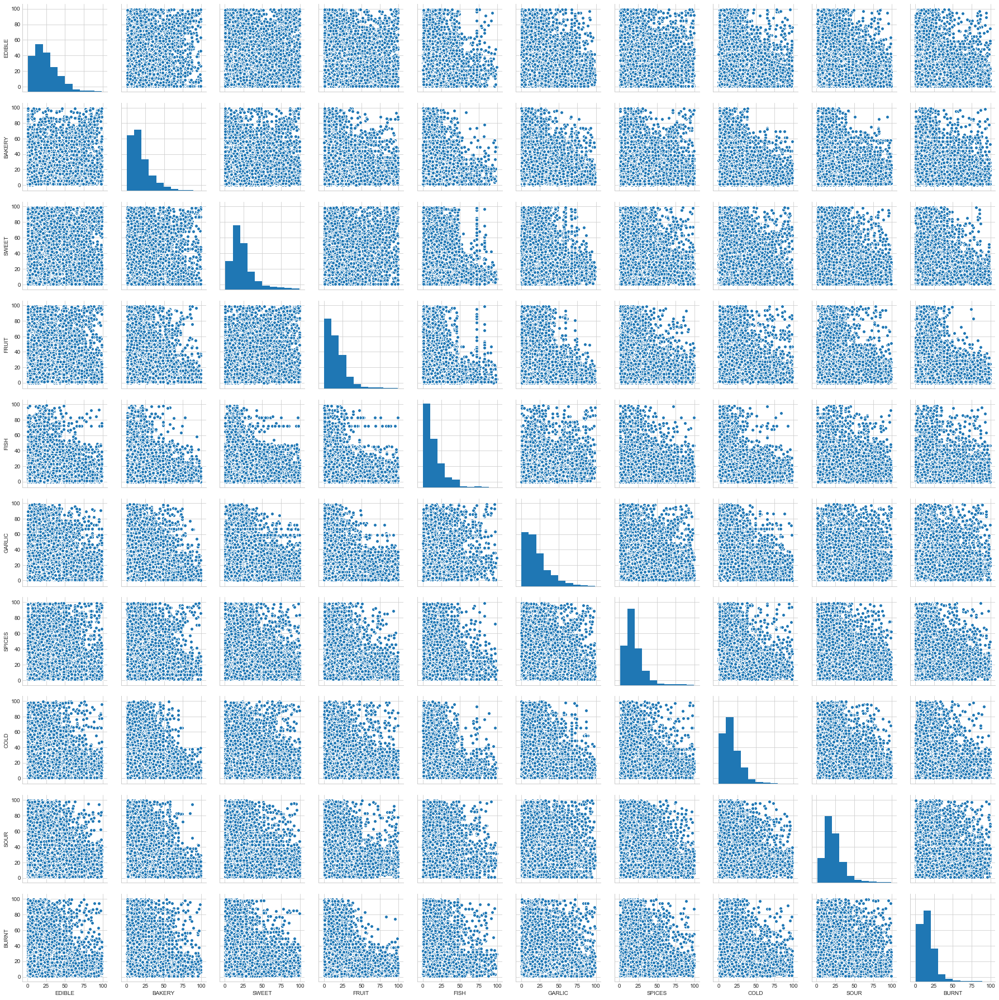

In [95]:
print("### Median Imputation ###") 
print("### Semantic Descriptors 1 ###") 
sb.pairplot(data=median_imputation.iloc[:, 18:28])

### Median Imputation ###
### Semantic Descriptors 2 ###


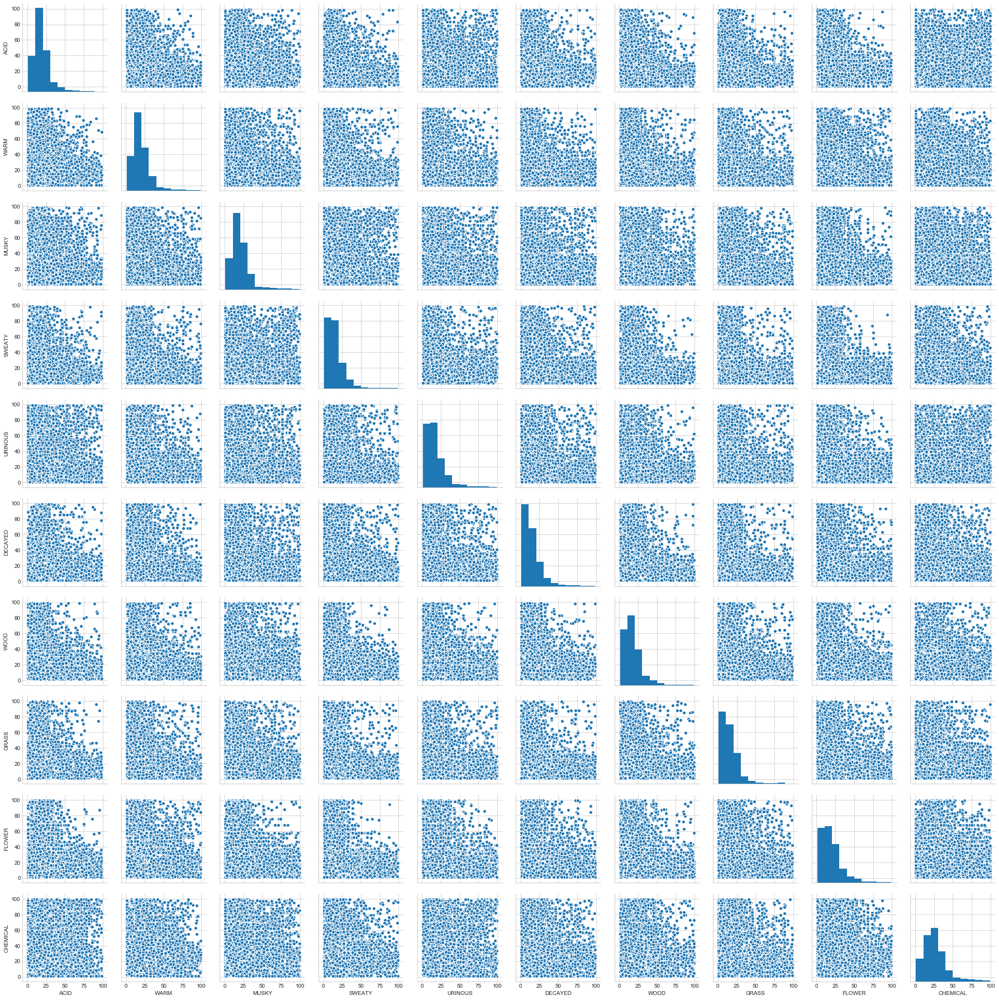

In [96]:
print("### Median Imputation ###") 
print("### Semantic Descriptors 2 ###") 
sb.pairplot(data=median_imputation.iloc[:, 28:38])

#### Mean / Median Average Imputation

### Mean/Median Averaged Imputation ###
### Semantic Descriptors 1 ###


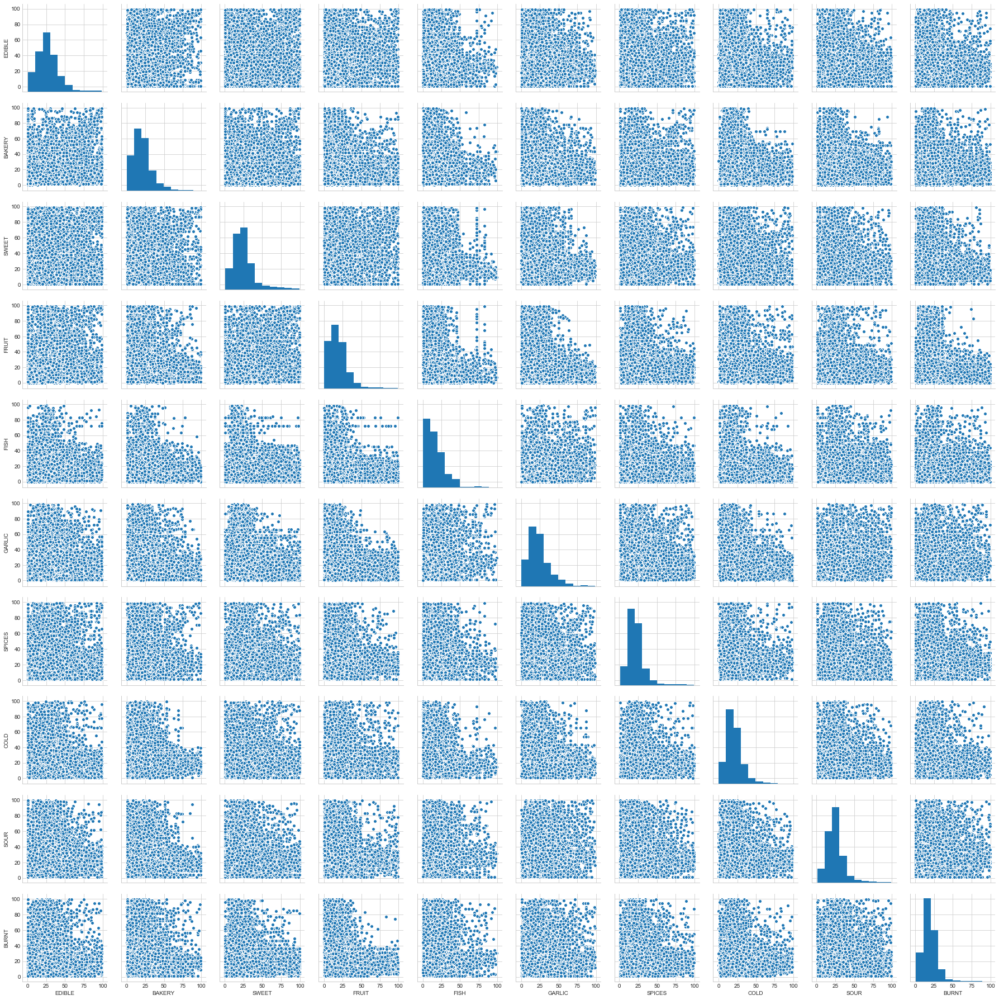

In [97]:
print("### Mean/Median Averaged Imputation ###") 
print("### Semantic Descriptors 1 ###") 
sb.pairplot(data=mean_median_average_imputation.iloc[:, 18:28])

### Mean/Median Averaged Imputation ###
### Semantic Descriptors 2 ###


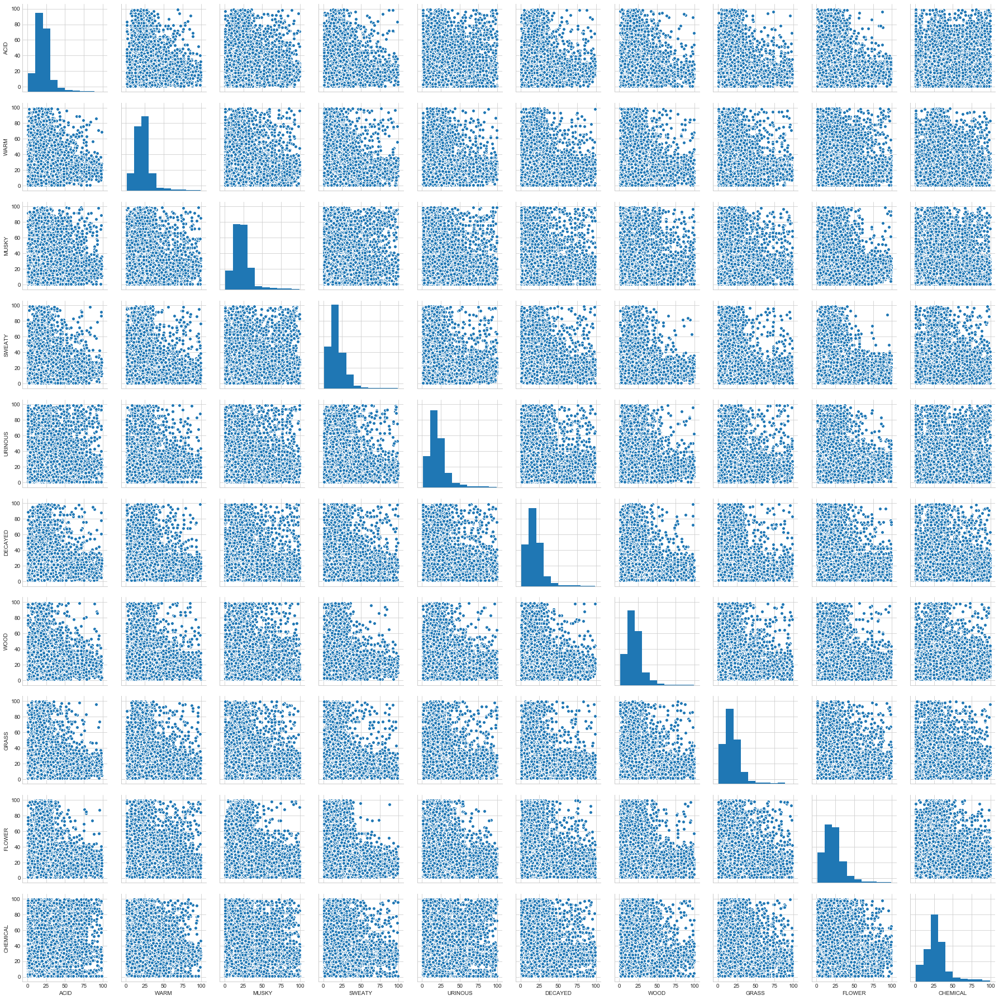

In [98]:
print("### Mean/Median Averaged Imputation ###") 
print("### Semantic Descriptors 2 ###") 
sb.pairplot(data=mean_median_average_imputation.iloc[:, 28:38])

### Studying Subject Responses

In [27]:
zero_imputation.shape

(42238, 38)

In [26]:
# scipy.sparse.issparse(zero_imputation.iloc[:, 15:38]) # Check if our matrix is sparse

# max_components = 23
pca = sklearn.decomposition.PCA(n_components=23)
principal_components = pca.fit_transform(mean_median_average_imputation.iloc[:, 15:38])
pca.explained_variance_ratio_

array([0.19674009, 0.15067839, 0.07582952, 0.07016509, 0.04695328,
       0.04427254, 0.03565877, 0.03216918, 0.03160747, 0.03042678,
       0.02737645, 0.02640329, 0.0251064 , 0.0237483 , 0.02313252,
       0.02310467, 0.02257166, 0.02079671, 0.02047674, 0.01981615,
       0.01865257, 0.017407  , 0.01690642])

In [51]:
mean_median_average_imputation.shape

(42238, 38)

In [39]:
pc1_pc2 = principal_components[:, 0:2]
principalDf = pd.DataFrame(data = pc1_pc2
             , columns = ['PC1', 'PC2'])
principalDf

,PC1,PC2
0,19.180029,12.170685
1,-8.543576,13.613374
2,-11.691992,-29.804398
3,-67.396491,-39.076713
4,-68.564170,-1.696354
5,56.901250,-41.759051
6,0.192934,-64.870421
7,4.001224,-76.240501
8,-66.731709,-5.648020
9,-66.519735,-0.200557


In [53]:
principalDf.index = mean_median_average_imputation.index
principalDf.insert(2, "SUBJECT", mean_median_average_imputation.iloc[:, 5])
principalDf.insert(2, "CID", mean_median_average_imputation.iloc[:, 2])
principalDf

,PC1,PC2,CID,SUBJECT
0,19.180029,12.170685,16741,1
1,-8.543576,13.613374,16741,1
2,-11.691992,-29.804398,17121,1
3,-67.396491,-39.076713,17121,1
4,-68.564170,-1.696354,520191,1
5,56.901250,-41.759051,520191,1
6,0.192934,-64.870421,92979,1
7,4.001224,-76.240501,92979,1
8,-66.731709,-5.648020,62580,1
9,-66.519735,-0.200557,62580,1


In [54]:
# Obtain the mean variation in response for subjects with respect to PC1 & PC2
subject_plot = principalDf.groupby("SUBJECT").mean()
race_per_subject = list(mean_median_average_imputation.groupby('Subject # (this study)')['Race'].min())
subject_plot.insert(2, "RACE", race_per_subject)
subject_plot

,PC1,PC2,RACE
SUBJECT,,,
1,-14.961329,-3.393365,Black
2,17.974948,14.630229,Black
3,7.206199,8.786792,Black
4,5.224669,10.798973,Black
5,-1.237699,1.427268,American Indian/Pacific Islander
6,-7.940489,3.115303,Black
7,10.845203,2.465890,Black
8,2.277165,-2.037866,American Indian/Pacific Islander
11,-1.707277,-11.286976,unknown


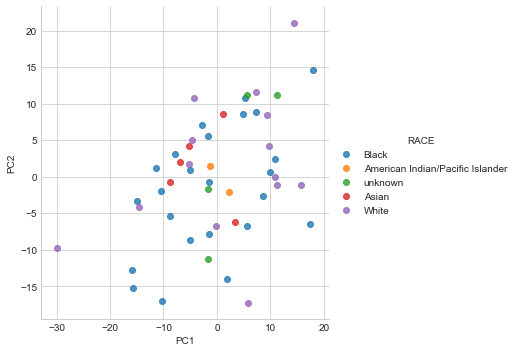

In [55]:
# Plot PCA results for mean response variation per subject by race

sb.lmplot(x="PC1", y="PC2", data=subject_plot, fit_reg=False, hue='RACE', legend=True)


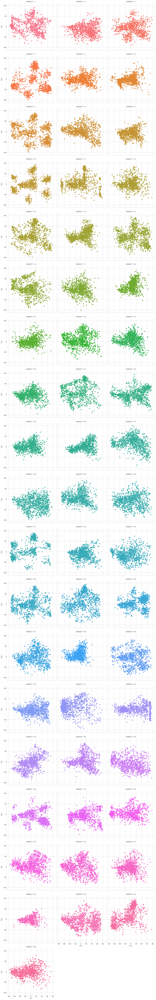

In [263]:
# Plot PCA results for each subjects variation in response w.r.t PC1 & PC2. 

sb.lmplot(
         x="PC1",
         y="PC2",
         data=principalDf,
         fit_reg=False,
         hue='SUBJECT',
         col='SUBJECT',
         col_wrap=3,
         legend=True)


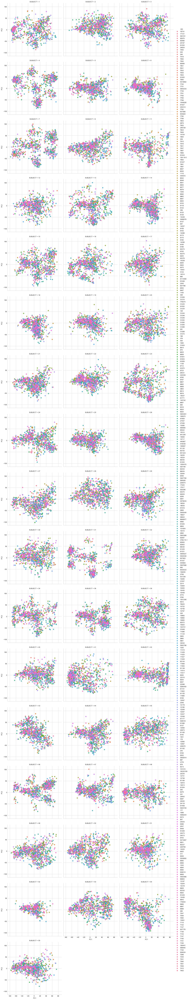

In [56]:
# Plot PCA results for each subjects variation in response w.r.t PC1 & PC2. 

sb.lmplot(
         x="PC1",
         y="PC2",
         data=principalDf,
         fit_reg=False,
         hue='CID',
         col='SUBJECT',
         col_wrap=3,
         legend=True)

### Latent Dirichlet Allocation

In [ ]:
lda = sklearn.decomposition.LatentDirichletAllocation(n_components=10)

### Correlation Matrices for differing imputation methods

### Mean Imputation ###


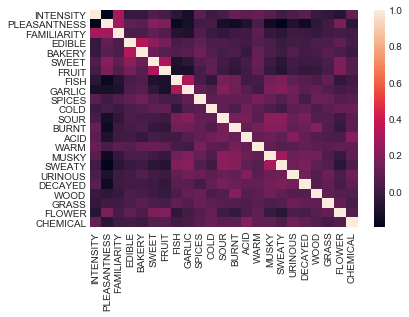

In [260]:
print("### Mean Imputation ###") 
corr = mean_imputation.iloc[:, 15:38].corr()
sb.heatmap(corr, 
          xticklabels=corr.columns.values,
          yticklabels=corr.columns.values)

### Median Imputation ###


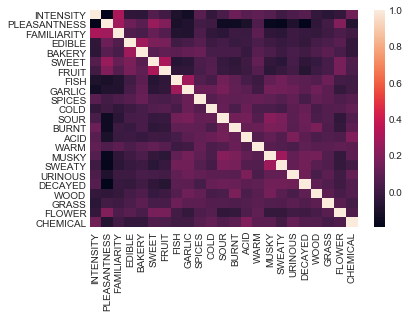

In [261]:
print("### Median Imputation ###") 
corr = median_imputation.iloc[:, 15:38].corr()
sb.heatmap(corr, 
          xticklabels=corr.columns.values,
          yticklabels=corr.columns.values)

### Zero Imputation ###


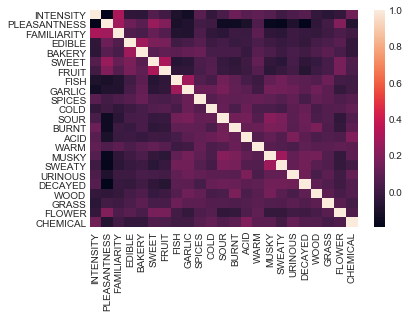

In [262]:
print("### Zero Imputation ###") 
corr = median_imputation.iloc[:, 15:38].corr()
sb.heatmap(corr, 
          xticklabels=corr.columns.values,
          yticklabels=corr.columns.values)

In [ ]:
def get_top_correlations(df, n=5):
    au_corr = df.corr().unstack()
    au_corr = au_corr.sort_values(ascending=False)
    return au_corr[20:(n*2+20):2]

In [ ]:
print("Top Absolute Correlations")
print(get_top_correlations(descriptors, 20))

## Molecular Descriptors - values describing the shape and features of the chemicals


In [57]:
molecular_descriptors = pd.read_pickle(path_to_transformed_data + "MOL_min_max_dropna.zip")

In [97]:
molecular_descriptors.shape
molecular_descriptors.head()

(476, 1009)

,CID,complexity from pubmed,MW,AMW,Sv,Se,Sp,Si,Mv,Me,...,Depressant-50,Psychotic-80,Hypertens-80,Hypertens-50,Hypnotic-80,Hypnotic-50,Neoplastic-80,Neoplastic-50,Infective-80,Infective-50
0,126,0.181128,0.270753,0.030587,0.262264,0.219126,0.253846,0.214989,0.216981,0.425532,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,176,0.060311,0.109331,0.025411,0.096943,0.105579,0.090940,0.107335,0.125214,0.659574,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,177,0.020039,0.067721,0.015501,0.075556,0.083688,0.078074,0.089782,0.106346,0.382979,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,180,0.051167,0.104208,0.011542,0.121231,0.131248,0.127898,0.139362,0.099485,0.269504,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,196,0.221790,0.333247,0.023779,0.306622,0.308572,0.294339,0.305729,0.138079,0.539007,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [74]:
pca = sklearn.decomposition.PCA(n_components=20)
principal_components = pca.fit_transform(molecular_descriptors.iloc[:, 1:])
pca.explained_variance_ratio_

array([0.36540041, 0.10841089, 0.04867553, 0.04219011, 0.03658062,
       0.03258411, 0.02190898, 0.01992195, 0.01746884, 0.01601055,
       0.01356504, 0.01133481, 0.01040033, 0.01012847, 0.00880657,
       0.00860102, 0.00782618, 0.0074456 , 0.00685023, 0.00660776])

In [111]:
mean_pleasantness = keller_data.groupby('CID')['PLEASANTNESS'].mean()
mean_pleasantness_df = pd.DataFrame(mean_pleasantness, columns=["CID", "PLEASANTNESS"])
mean_pleasantness_df['CID'] = list(mean_pleasantness.index.values)
mean_pleasantness_df

,CID,PLEASANTNESS
CID,,
126,126,50.303371
176,176,47.104167
177,177,48.878378
180,180,54.132353
196,196,46.587302
239,239,50.189189
240,240,62.639535
241,241,46.083333
243,243,45.984127


In [98]:
mol_pc1_pc2 = principal_components[:, 0:2]
mol_principalDf = pd.DataFrame(data = mol_pc1_pc2
             , columns = ['PC1', 'PC2'])
mol_principalDf

,PC1,PC2
0,-1.974841,2.070628
1,-5.900557,-1.386701
2,-6.320693,-1.533691
3,-5.608431,-1.462347
4,-0.897628,-1.144984
5,-4.355680,-0.890138
6,-2.485009,1.846341
7,-4.250284,1.135489
8,-1.947137,1.799275
9,-2.203336,1.574577


In [113]:
#mol_principalDf.insert(2, "CID", molecular_descriptors.iloc[:, 0])
average_pleasentness_pc1_pc2 = pd.merge(mol_principalDf, mean_pleasantness_df, on='CID')
average_pleasentness_pc1_pc2

,PC1,PC2,CID,PLEASANTNESS


In [115]:
mol_principalDf
mean_pleasantness_df.index = mol_principalDf.index

,PC1,PC2,CID
0,-1.974841,2.070628,126
1,-5.900557,-1.386701,176
2,-6.320693,-1.533691,177
3,-5.608431,-1.462347,180
4,-0.897628,-1.144984,196
5,-4.355680,-0.890138,239
6,-2.485009,1.846341,240
7,-4.250284,1.135489,241
8,-1.947137,1.799275,243
9,-2.203336,1.574577,244


ValueError: Length mismatch: Expected axis has 480 elements, new values have 476 elements

In [ ]:
# Plot PCA results for each subjects variation in response w.r.t PC1 & PC2. 

sb.lmplot(
         x="PC1",
         y="PC2",
         data=principalDf,
         fit_reg=False,
         hue='SUBJECT',
         col='SUBJECT',
         col_wrap=3,
         legend=True)
